In [3]:
import scanpy as sc
from pathlib import Path
import pandas as pd
import squidpy as sq
from sklearn.preprocessing import MinMaxScaler

# from muon import prot as pt
# from muon import MuData
# import muon as mu
import numpy as np
from jax.config import config
import matplotlib.pyplot as plt

config.update("jax_enable_x64", True)
import mplscience

mplscience.available_styles()
mplscience.set_style(reset_current=True)
plt.rcParams["legend.scatterpoints"] = 1
%load_ext autoreload
%autoreload 2
%load_ext lab_black

path_data = Path("/lustre/groups/ml01/workspace/moscot_paper/mapping")

['default', 'despine']
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
The lab_black extension is already loaded. To reload it, use:
  %reload_ext lab_black


In [4]:
adata_sc = sc.read(path_data / "adata_sc_out.h5ad")
adata_p = sc.read(path_data / "adata_cite_processed.h5ad")

/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


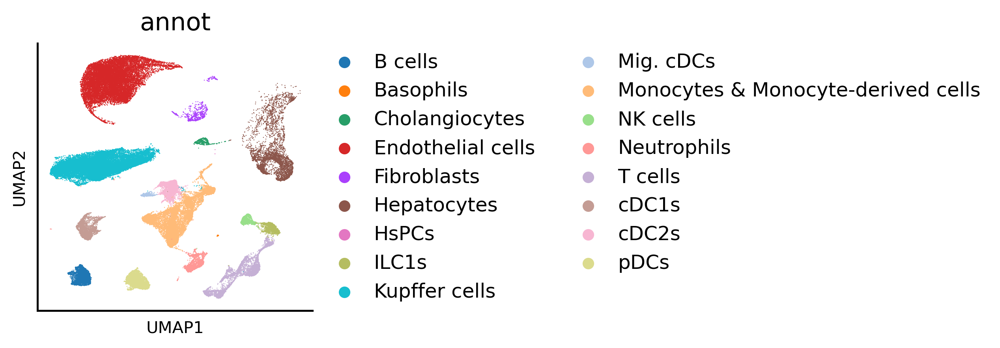

In [8]:
fig, ax = plt.subplots(figsize=(3, 3), dpi=300)
sc.pl.umap(adata_sc, color="annot", ax=ax)

/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


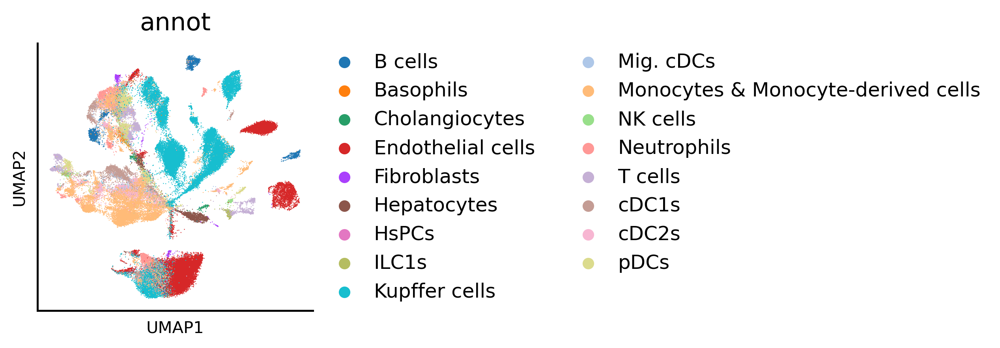

In [10]:
fig, ax = plt.subplots(figsize=(3, 3), dpi=300)
sc.pl.umap(adata_p, color="annot", ax=ax)

In [16]:
{k: v for k, v in zip(adata_p.obs.annot.cat.categories, adata_p.uns["annot_colors"])}

{'B cells': '#1f77b4',
 'Basophils': '#ff7f0e',
 'Cholangiocytes': '#279e68',
 'Endothelial cells': '#d62728',
 'Fibroblasts': '#aa40fc',
 'Hepatocytes': '#8c564b',
 'HsPCs': '#e377c2',
 'ILC1s': '#b5bd61',
 'Kupffer cells': '#17becf',
 'Mig. cDCs': '#aec7e8',
 'Monocytes & Monocyte-derived cells': '#ffbb78',
 'NK cells': '#98df8a',
 'Neutrophils': '#ff9896',
 'T cells': '#c5b0d5',
 'cDC1s': '#c49c94',
 'cDC2s': '#f7b6d2',
 'pDCs': '#dbdb8d'}

In [18]:
sc.tl.rank_genes_groups(adata_p, groupby="annot", method="wilcoxon")

/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:2414: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  obs_tidy.index.value_counts(sort=False).iteritems()


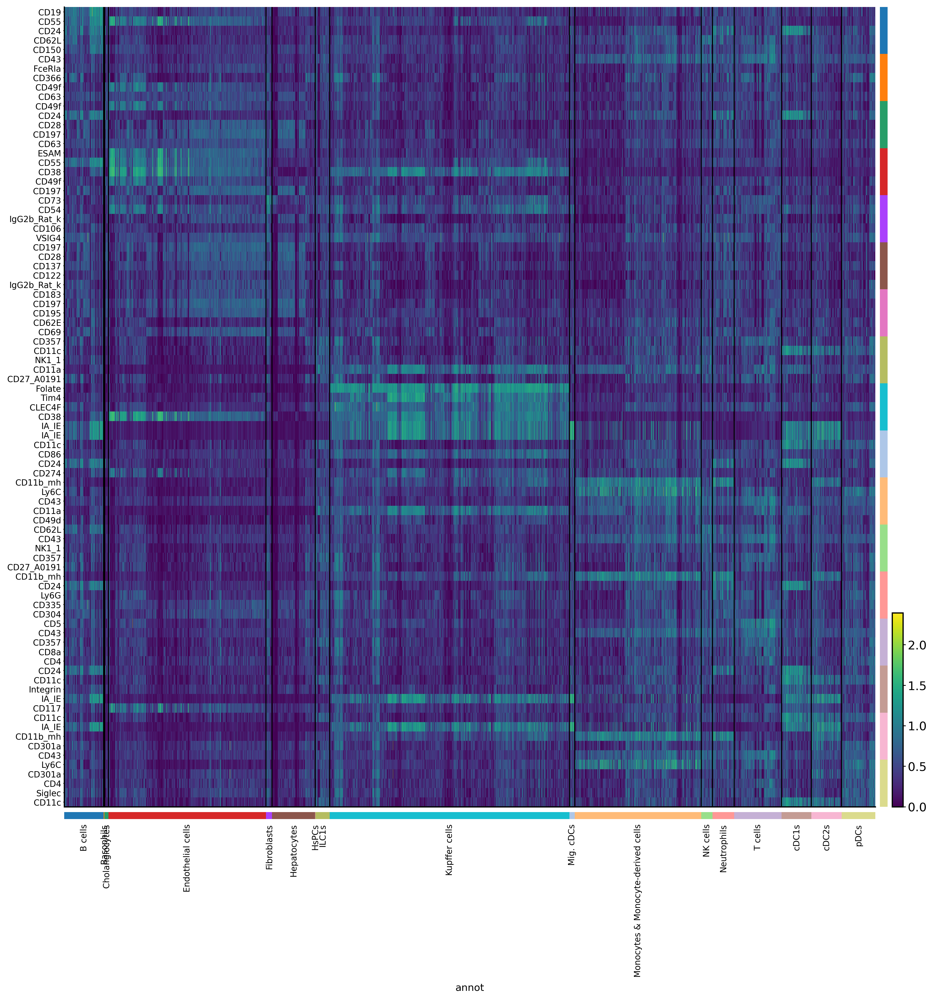

<Figure size 1800x1200 with 0 Axes>

In [48]:
from matplotlib.pyplot import rcParams

rcParams["figure.dpi"] = 300
sc.pl.rank_genes_groups_heatmap(
    adata_p,
    dendrogram=False,
    log=True,
    # categories_order=adata_p.obs.annot.cat.categories,
    n_genes=5,
    show_gene_labels=True,
    figsize=(15, 15),
    swap_axes=True,
)
plt.tight_layout()

In [10]:
sc.tl.rank_genes_groups(adata_spatial_prot, groupby="celltype_mapped")

In [11]:
sc.tl.rank_genes_groups(adata_p, "annot")

NameError: name 'adata_p' is not defined

In [12]:
sc.get.rank_genes_groups_df(adata_spatial_prot, "Kupffer cells").head(10)

,names,scores,logfoldchanges,pvals,pvals_adj
0,Folate,577.786499,1.915524,0.0,0.0
1,Tim4,475.106934,1.213754,0.0,0.0
2,CLEC4F,428.948639,0.840817,0.0,0.0
3,F4_80,348.426697,0.758615,0.0,0.0
4,IA_IE,344.137421,0.823931,0.0,0.0
5,CD14,329.617401,0.782823,0.0,0.0
6,CD11a,310.828827,0.748084,0.0,0.0
7,CD86,307.999359,0.607345,0.0,0.0
8,CD64,252.346802,0.441410,0.0,0.0
9,CD278,239.637421,0.435812,0.0,0.0


In [7]:
sc.get.rank_genes_groups_df(adata_spatial_prot, "Neutrophil").head(10)

,names,scores,logfoldchanges,pvals,pvals_adj
0,CD309_A0554,55.717579,0.053998,0.0,0.0
1,CD16_CD32,55.479897,0.156384,0.0,0.0
2,CD24,54.525562,0.224030,0.0,0.0
3,CD43,54.354961,0.146770,0.0,0.0
4,CD5,53.287758,0.181140,0.0,0.0
5,CD62L,53.149933,0.163026,0.0,0.0
6,CD11b_mh,51.848255,0.277544,0.0,0.0
7,CD206,51.728565,0.165792,0.0,0.0
8,CD11c,51.533401,0.156193,0.0,0.0
9,MERTK,50.408474,0.322039,0.0,0.0


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


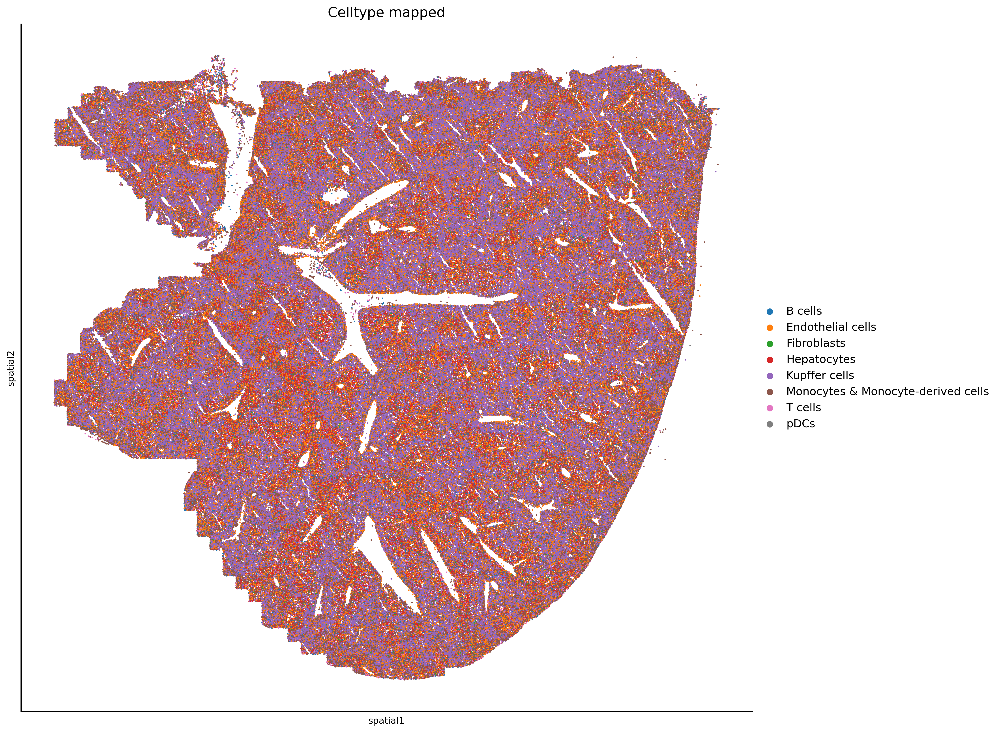

In [19]:
sq.pl.spatial_scatter(
    adata_spatial_prot,
    shape=None,
    color=["celltype_mapped"],
    # groups="Neutrophils",
    size=1,
    hspace=1,
    figsize=(15, 15),
    title="Celltype mapped",
    dpi=300,
)

In [8]:
adata_spatial_prot.obs["leiden_map"] = adata_spatial.obs["leiden_map"].copy()

In [ ]:
sq.pl.spatial_scatter(
    adata_spatial_prot,
    size=1,
    shape=None,
    color=["CD16_CD32", "CD24", "CD43", "CD11b_mh"],
    groups="Neutrophil",
    figsize=(5, 5),
    dpi=300,
)
plt.tight_layout()

/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.9/site-packages/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/tmp/ipykernel_78336/1181611199.py:10: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


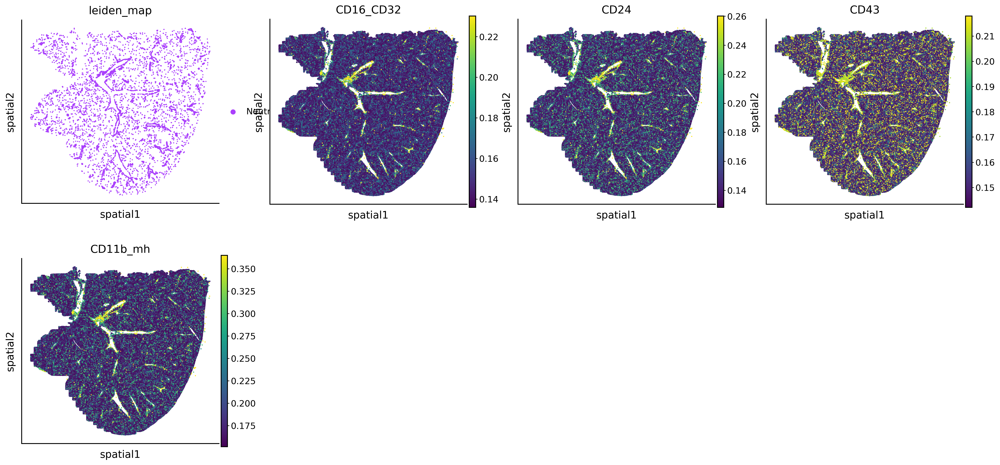

In [13]:
sq.pl.spatial_scatter(
    adata_spatial_prot,
    size=1,
    shape=None,
    color=["CD16_CD32", "CD24", "CD43", "CD11b_mh"],
    groups="Neutrophil",
    figsize=(5, 5),
    dpi=300,
)
plt.tight_layout()

/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


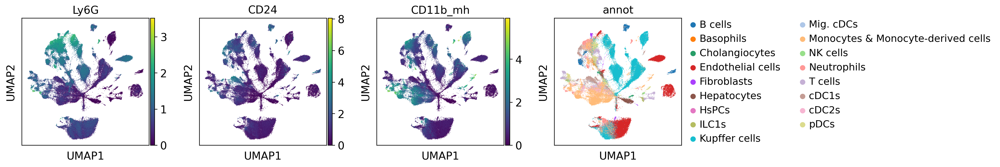

<Figure size 300x300 with 0 Axes>

In [60]:
sc.pl.umap(
    adata_p,
    color=["Ly6G", "CD24", "CD11b_mh", "annot"],
)
plt.tight_layout()

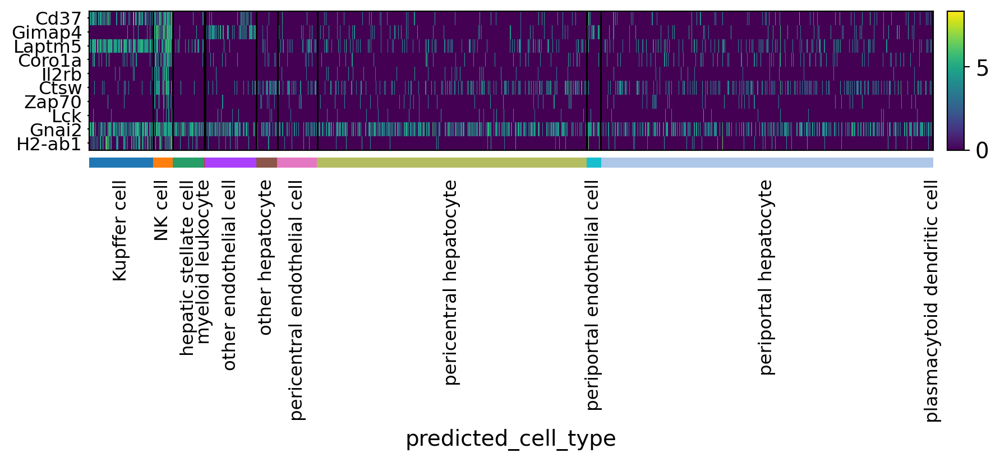

In [46]:
sc.pl.heatmap(
    adata_spatial,
    df_genes.names.values,
    groupby="predicted_cell_type",
    swap_axes=True,
)